<a href="https://colab.research.google.com/github/TVRCharan-cbit/iva-assignment/blob/main/IVAassignmentPartB.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Saving Testimage.jpg to Testimage (1).jpg
Displaying the resized image:


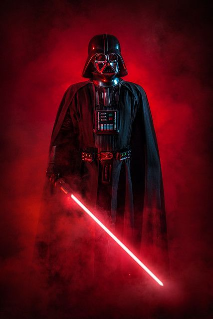

Dominant Color (RGB): (78, 4, 13)
Detected Color: Maroon


In [3]:
#Q1. Create a sample project to detect colours in an image
import cv2
import numpy as np
from google.colab import files
from google.colab.patches import cv2_imshow

def get_dominant_color(image):
    if image is None:
        raise ValueError("Invalid image provided")

    img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    pixels = img.reshape((-1, 3))

    # K-Means Clustering Parameters
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 200, 0.1)
    k = 5
    _, labels, centers = cv2.kmeans(
        pixels.astype(np.float32), k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS
    )

    dominant_color = centers[np.argmax(np.unique(labels, return_counts=True)[1])]
    return tuple(map(int, dominant_color))

def get_color_name(rgb_tuple):
    color_names = {
        (255, 0, 0): 'Red',
        (0, 255, 0): 'Green',
        (0, 0, 255): 'Blue',
        (0, 0, 0): 'Black',
        (255, 255, 255): 'White',
        (255, 255, 0): 'Yellow',
        (0, 255, 255): 'Cyan',
        (255, 0, 255): 'Magenta',
        (192, 192, 192): 'Silver',
        (128, 128, 128): 'Gray',
        (128, 0, 0): 'Maroon',
        (128, 128, 0): 'Olive',
        (0, 128, 0): 'Dark Green',
        (128, 0, 128): 'Purple',
        (0, 128, 128): 'Teal',
        (0, 0, 128): 'Navy',
    }

    min_distance = float('inf')
    closest_color = None
    for color, name in color_names.items():
        distance = np.linalg.norm(np.array(rgb_tuple) - np.array(color))
        if distance < min_distance:
            min_distance = distance
            closest_color = name

    return closest_color

# Upload Image
uploaded = files.upload()
filename = list(uploaded.keys())[0]
image = cv2.imread(filename)

if image is None:
    print("Error: Unable to load image.")
else:
    print("Displaying the resized image:")

    # Resize image while maintaining aspect ratio
    scale_percent = 50  # Resize to 50% of the original
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    resized_image = cv2.resize(image, (width, height))

    cv2_imshow(resized_image)

    dominant_color = get_dominant_color(image)
    print("Dominant Color (RGB):", dominant_color)

    color_name = get_color_name(dominant_color)
    print(f"Detected Color: {color_name if color_name else 'Unknown'}")


Saving Testimage.jpg to Testimage (2).jpg
Original Image:


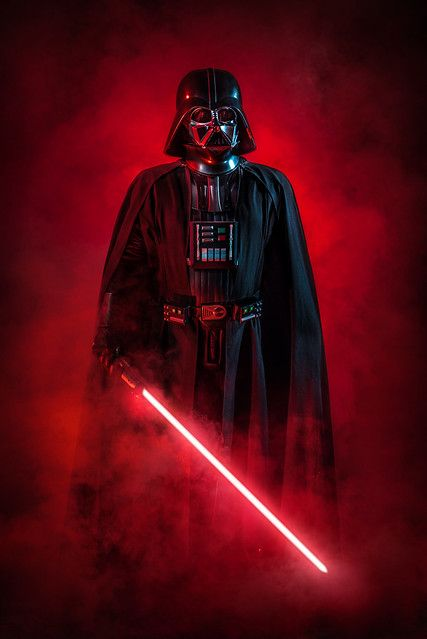

Pyramid Level 0:


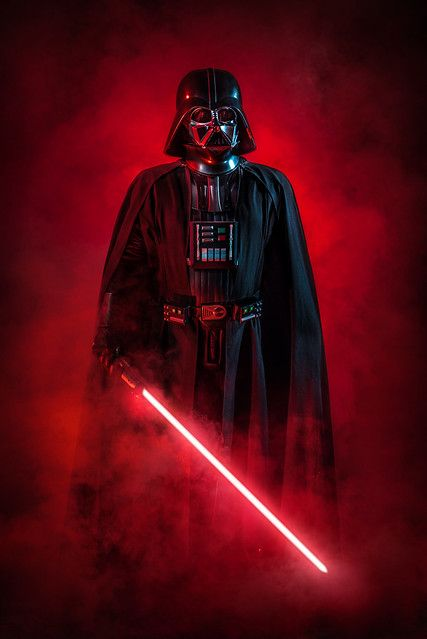

Pyramid Level 1:


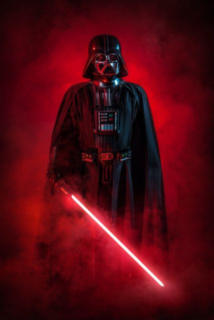

Pyramid Level 2:


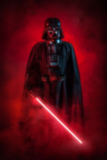

Pyramid Level 3:


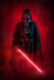

In [4]:
#Q2. Data structures for Image Analysis -Write a program
that computes the T-pyramid of an image.
import cv2
from google.colab import files
from google.colab.patches import cv2_imshow

def build_t_pyramid(image, levels=3):
    """Build a T-pyramid for the given image."""
    pyramid = [image]
    temp_image = image.copy()

    # Iteratively downsample the image
    for i in range(levels):
        temp_image = cv2.pyrDown(temp_image)
        pyramid.append(temp_image)

    return pyramid

# Upload image in Colab
uploaded = files.upload()
filename = list(uploaded.keys())[0]

# Load and display the image
image = cv2.imread(filename)
if image is None:
    print("Error: Unable to load image.")
else:
    print("Original Image:")
    cv2_imshow(image)

    # Build and display the T-pyramid
    levels = 3
    pyramid = build_t_pyramid(image, levels)

    for i, level_image in enumerate(pyramid):
        print(f"Pyramid Level {i}:")
        cv2_imshow(level_image)


Saving Testimage.jpg to Testimage (3).jpg
Original Image:


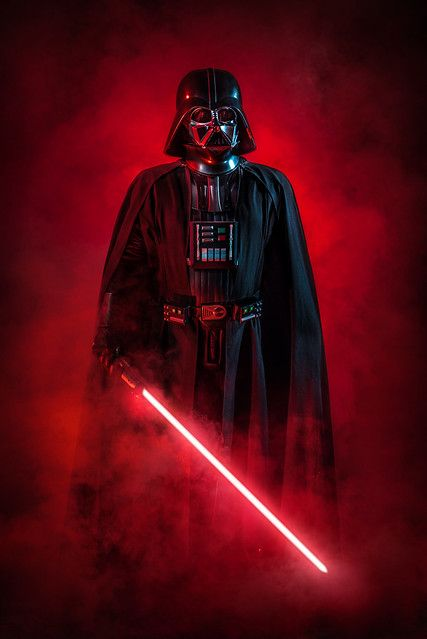

Averaging Blur (5x5 Kernel):


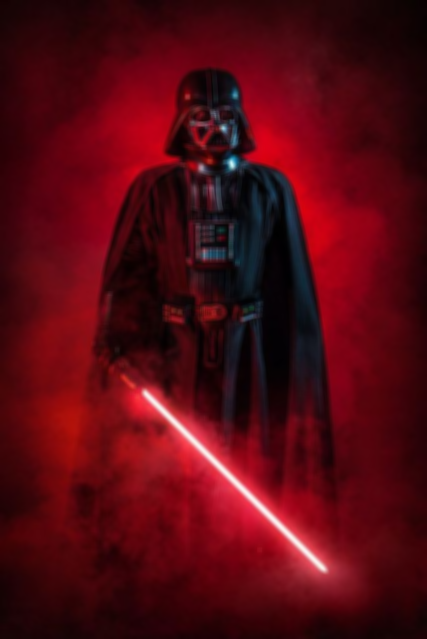

Gaussian Blur (5x5 Kernel):


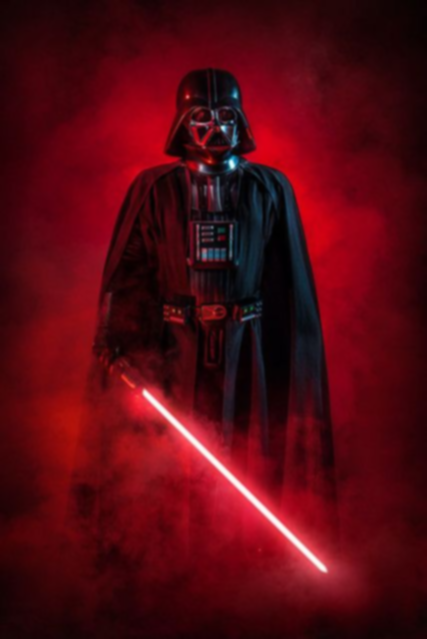

Median Blur (5x5 Kernel):


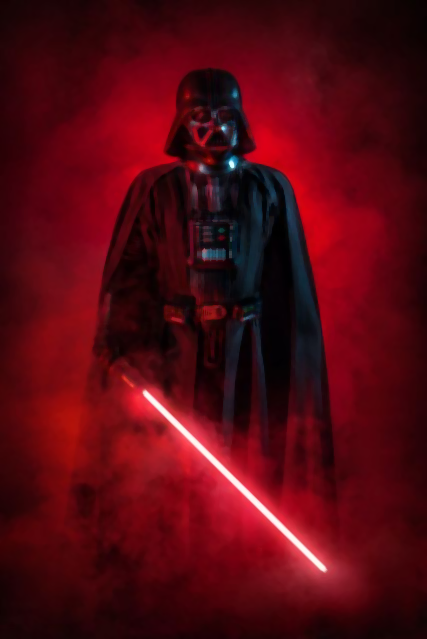

Bilateral Filter (d=9, σColor=75, σSpace=75):


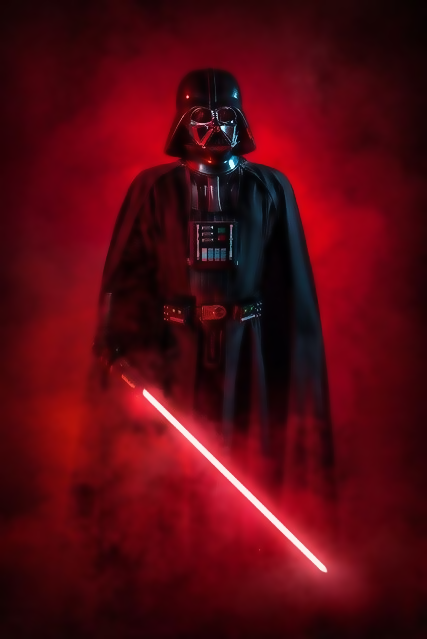

In [5]:
#Q3. Create a sample project for Image Smoothing.
import cv2
import numpy as np
from google.colab import files
from google.colab.patches import cv2_imshow

def apply_smoothing(image):
    """Apply different smoothing techniques to an image."""

    # 1. Original Image
    print("Original Image:")
    cv2_imshow(image)

    # 2. Averaging Blur
    average_blur = cv2.blur(image, (5, 5))
    print("Averaging Blur (5x5 Kernel):")
    cv2_imshow(average_blur)

    # 3. Gaussian Blur
    gaussian_blur = cv2.GaussianBlur(image, (5, 5), 0)
    print("Gaussian Blur (5x5 Kernel):")
    cv2_imshow(gaussian_blur)

    # 4. Median Blur
    median_blur = cv2.medianBlur(image, 5)
    print("Median Blur (5x5 Kernel):")
    cv2_imshow(median_blur)

    # 5. Bilateral Filter (Preserves edges)
    bilateral_blur = cv2.bilateralFilter(image, 9, 75, 75)
    print("Bilateral Filter (d=9, σColor=75, σSpace=75):")
    cv2_imshow(bilateral_blur)

# Upload image in Colab
uploaded = files.upload()
filename = list(uploaded.keys())[0]

# Load and process the image
image = cv2.imread(filename)
if image is None:
    print("Error: Unable to load image.")
else:
    apply_smoothing(image)


Saving Testimage.jpg to Testimage (4).jpg
Grayscale Image:


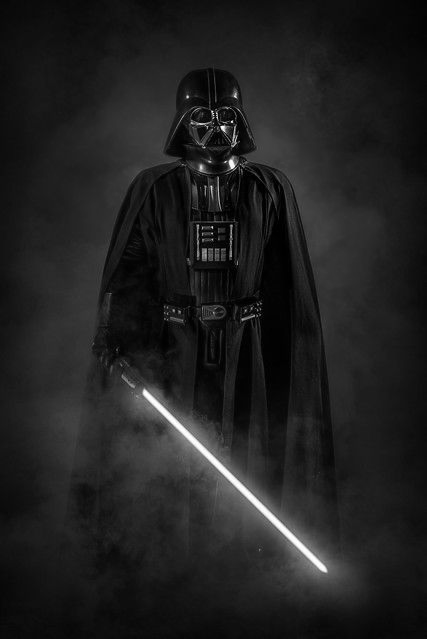

Sobel X Edge Detection:


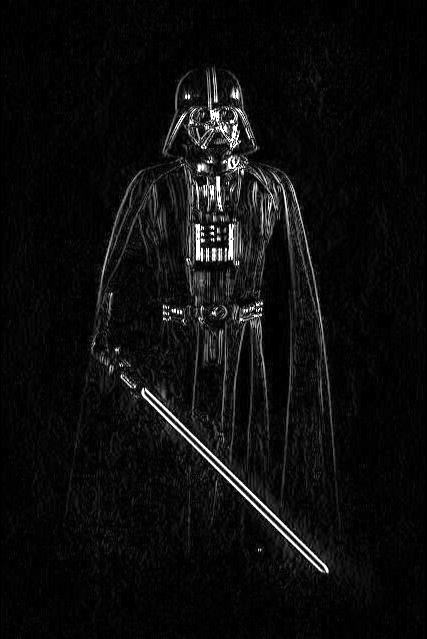

Sobel Y Edge Detection:


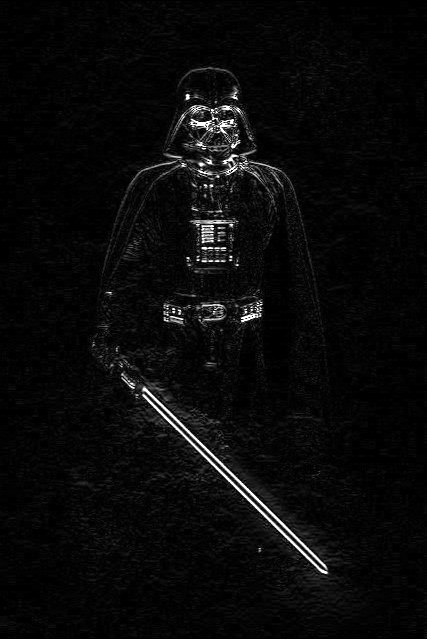

Combined Sobel Edge Detection:


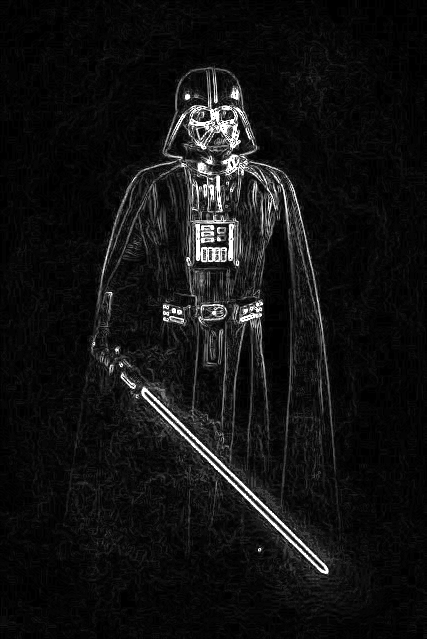

Canny Edge Detection (Thresholds: 100, 200):


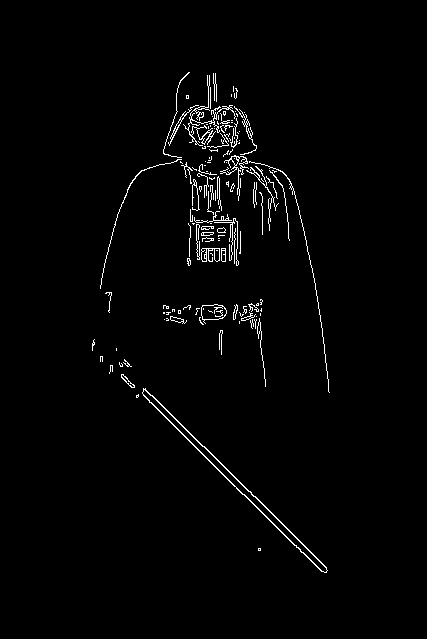

In [6]:
#Q4. Create a sample project for Edge detection using Sobel, Canny edge.
import cv2
import numpy as np
from google.colab import files
from google.colab.patches import cv2_imshow

def apply_edge_detection(image):
    """Apply Sobel and Canny edge detection to an image."""

    # Convert to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    print("Grayscale Image:")
    cv2_imshow(gray_image)

    # Sobel Edge Detection
    sobel_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)
    sobel_combined = cv2.bitwise_or(cv2.convertScaleAbs(sobel_x), cv2.convertScaleAbs(sobel_y))

    print("Sobel X Edge Detection:")
    cv2_imshow(cv2.convertScaleAbs(sobel_x))

    print("Sobel Y Edge Detection:")
    cv2_imshow(cv2.convertScaleAbs(sobel_y))

    print("Combined Sobel Edge Detection:")
    cv2_imshow(sobel_combined)

    # Canny Edge Detection
    canny_edges = cv2.Canny(gray_image, 100, 200)
    print("Canny Edge Detection (Thresholds: 100, 200):")
    cv2_imshow(canny_edges)

# Upload image in Colab
uploaded = files.upload()
filename = list(uploaded.keys())[0]

# Load and process the image
image = cv2.imread(filename)
if image is None:
    print("Error: Unable to load image.")
else:
    apply_edge_detection(image)


Saving WhatsApp Image 2025-03-10 at 2.57.19 PM.jpeg to WhatsApp Image 2025-03-10 at 2.57.19 PM.jpeg
Detected Objects (Face and Eyes):


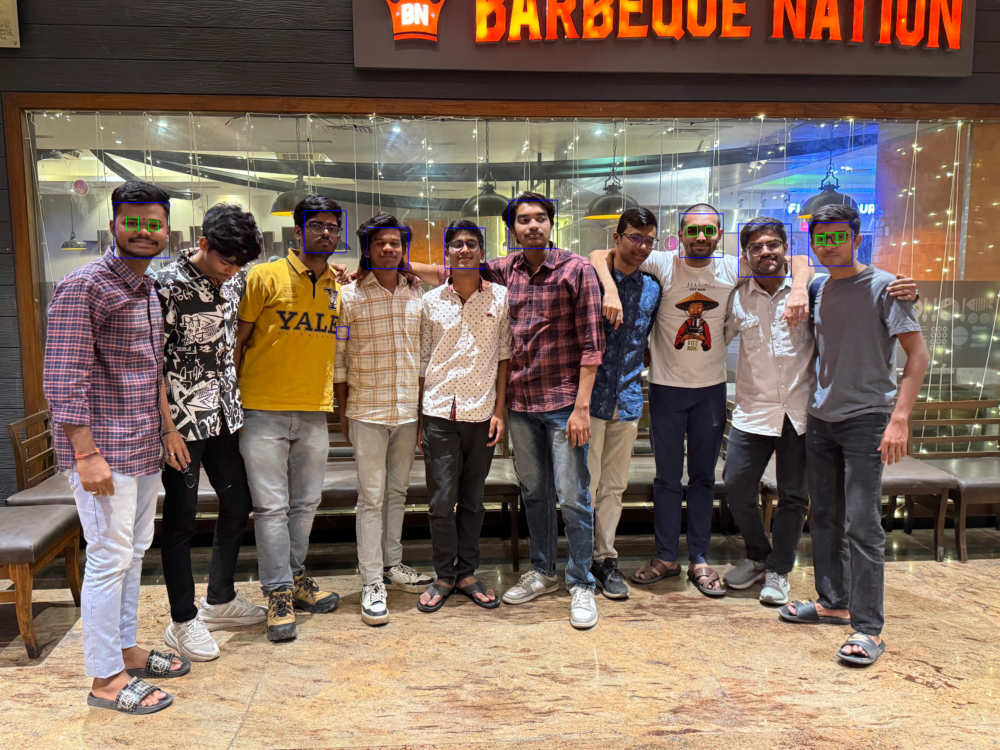

In [7]:
#Object Detection with OpenCV :-
#• Detect simple objects like faces or eyes or hands using OpenCV and Haar cascades
#• Library : OpenCV, NumPy
import cv2
import numpy as np
from google.colab import files
from google.colab.patches import cv2_imshow

# Load Haar cascade classifiers
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')

def detect_objects(image):
    """Detect faces and eyes in the image using Haar cascades."""
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Detect faces
    faces = face_cascade.detectMultiScale(gray_image, 1.3, 5)

    for (x, y, w, h) in faces:
        # Draw a rectangle around the face
        cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_gray = gray_image[y:y + h, x:x + w]
        roi_color = image[y:y + h, x:x + w]

        # Detect eyes within the face region
        eyes = eye_cascade.detectMultiScale(roi_gray)
        for (ex, ey, ew, eh) in eyes:
            cv2.rectangle(roi_color, (ex, ey), (ex + ew, ey + eh), (0, 255, 0), 2)

    # Show the result
    print("Detected Objects (Face and Eyes):")
    cv2_imshow(image)

# Upload image in Colab
uploaded = files.upload()
filename = list(uploaded.keys())[0]

# Load and process the image
image = cv2.imread(filename)
if image is None:
    print("Error: Unable to load image.")
else:
    detect_objects(image)
